# Diarization for ML

## Import modules

Загружаем необходимые библиотеки:

In [1]:
#!pip install librosa
#!pip install pydub
#!pip install soundfile
import numpy as np
import IPython.display as ipd
import soundfile as sf
import os
from pathlib import Path
from math import ceil
from pydub import AudioSegment
from timeit import default_timer as timer
from pydub.silence import split_on_silence
import math
#import matplotlib
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.ensemble import IsolationForest
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
import random
import pandas as pd
from tqdm.auto import tqdm
import warnings
warnings.filterwarnings(action='ignore') 

In [2]:
import librosa
import librosa.display

## Load audio

#### Convert mp3 to Wav

Предаврительно конвертируем файл в формат WAV

In [3]:
#audiofile = "input/InterviewTwoP.mp3"
audiofile = "input/InterviewTwoP.mp3"
name = Path(audiofile).stem
namewav = os.path.join(name + '.wav')
# data, samplerate = sf.read(audiofile)
# sf.write("input/" + namewav, data, samplerate)
wavfile = os.path.join("input/" + namewav)

sound = AudioSegment.from_mp3(audiofile)
sound.export(wavfile, format="wav")

<_io.BufferedRandom name='input/InterviewTwoP.wav'>

In [4]:
exportpath = "export/tmp/"

Первоначальный файл

In [5]:
ipd.Audio(wavfile)

In [6]:
y, source_sample_rate = librosa.load(wavfile)
y,source_sample_rate

(array([ 5.8207661e-11, -1.4551915e-11, -1.0186341e-10, ...,
         2.3283064e-10,  2.3283064e-10,  2.3283064e-10], dtype=float32),
 22050)

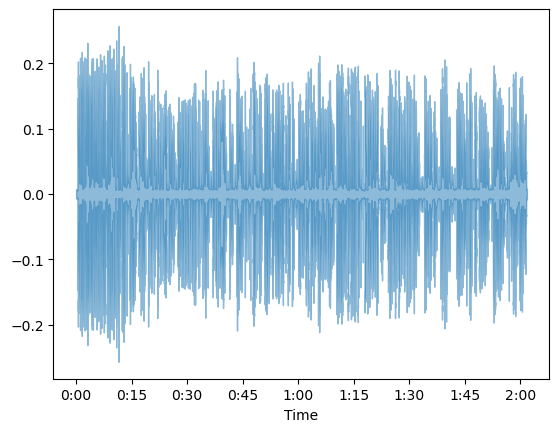

In [7]:
librosa.display.waveshow(y, sr=source_sample_rate, alpha=0.5)

## Remove Silence

Удаляем тишину из файла. Для анализа она бесполезна

In [9]:
clips = librosa.effects.split(y, top_db=20)

In [10]:
namesilence = name + 'wtsilence' + '.wav'
wav_data = []
for c in clips:
    print(c)
    data = y[c[0]: c[1]]
    wav_data.extend(data)
sf.write(namesilence, wav_data, source_sample_rate)

[  7680 233984]
[237568 267776]
[271360 296448]
[298496 308736]
[310272 361472]
[371200 417280]
[420864 426496]
[428032 456704]
[458240 471552]
[473088 479744]
[481792 496128]
[498176 514048]
[515072 539648]
[544256 544768]
[549888 576000]
[577024 588288]
[595456 596992]
[604160 627200]
[628736 644096]
[645632 657408]
[658432 670720]
[674816 683520]
[686080 698880]
[700416 711680]
[712192 716288]
[724480 729600]
[730112 736768]
[744960 747520]
[751616 754688]
[755200 790016]
[790528 793088]
[800768 804864]
[812544 825344]
[828928 837120]
[839680 853504]
[854016 894464]
[911360 934912]
[945152 947200]
[947712 950272]
[954368 988160]
[988672 998912]
[1005056 1015296]
[1020928 1026560]
[1027072 1039872]
[1040896 1042944]
[1044992 1049600]
[1052160 1072128]
[1072640 1080832]
[1082880 1084928]
[1086464 1107968]
[1120256 1159168]
[1165824 1238528]
[1244672 1253888]
[1256448 1260032]
[1261056 1274880]
[1283584 1299456]
[1308672 1315840]
[1323008 1360896]
[1365504 1386496]
[1396224 1465856]
[1

#### Clear noise

In [11]:
#!pip install noisereduce

In [12]:
from scipy.io import wavfile
import noisereduce as nr
audioredicednoice = name + 'reduced_noise.wav'
# load data
rate, data = wavfile.read(namesilence)
# perform noise reduction
reduced_noise = nr.reduce_noise(y=data, sr=rate)
wavfile.write(audioredicednoice, rate, reduced_noise)

Файл очишенный от тишины

In [13]:
ipd.Audio(namesilence)

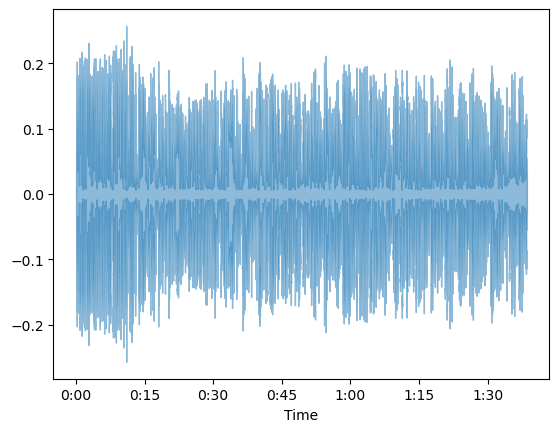

In [14]:
audio, sr = librosa.load(namesilence)
librosa.display.waveshow(audio, sr=sr, alpha=0.5)

## Split Chunks

Разбиваем файл на фрагменты длинной 1 секунда

In [15]:
audio, sr = librosa.load(namesilence)
# # Get number of samples for 1 seconds; replace 1 by any number

buffer = 1 * sr

samples_total = len(audio)
samples_wrote = 0
counter = 1
exportpath = "export/tmp/"

while samples_wrote < samples_total:
    #check if the buffer is not exceeding total samples 
    if buffer > (samples_total - samples_wrote):
        buffer = samples_total - samples_wrote

    block = audio[samples_wrote : (samples_wrote + buffer)]
    out_filename = exportpath + name + str(counter) +  '.wav'

    # Write 1 second segment
    sf.write(out_filename, block, sr)
    counter += 1
    samples_wrote += buffer

Пример одного фрамента

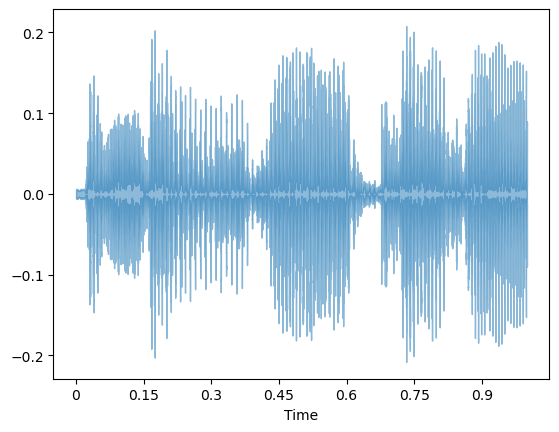

In [16]:
chankdata,_ = librosa.load('export/tmp/InterviewTwoP1.wav')
librosa.display.waveshow(chankdata, sr=sr, alpha=0.5)

In [17]:
# def chunks(file):
#     exportpath = "export/tmp/"
#     sound_file = AudioSegment.from_wav(file)
#     audio_chunks = split_on_silence(sound_file, min_silence_len=45, silence_thresh=10)
#     for i, chunk in enumerate(audio_chunks):
#          out_file = exportpath + "chunk{0}.wav".format(i)
#          chunk.export(out_file, format="wav")

In [18]:
#chunks(wavfile)

## Extract features

Объявляем функцию для получения мел-кепстральных коэффициентов из аудиофайла

In [19]:
def feature_exttraction_norm(file,N):
    #load file`
    sample_rate = 16000
    x,_ = librosa.load(file)
    #Extract features from file
    mfcc = np.mean(librosa.feature.mfcc(y=x, sr=sample_rate, n_mfcc=N, norm = 'ortho',dct_type=3).T, axis=0)
    #mfcc = librosa.feature.mfcc(y=x, sr=sample_rate, n_mfcc=N)
    #mfcc = np.mean(librosa.stft(y=x, n_fft=N_MFCC).T, axis=0)
    #normolize
    normmfcc = librosa.util.normalize(mfcc,norm=0.9)
    return normmfcc

In [ ]:
CH_MFCCS = dict()
for ch in os.listdir(exportpath):  
    #rint(ch)
    file = exportpath + ch
    #print(ch)
    mfcc = feature_exttraction_norm(file,256)
    CH_MFCCS[ch] = mfcc
sorted_keys = sorted(list(CH_MFCCS.keys()), key = lambda x: (len(x),x))
CH_MFCCS = {k:CH_MFCCS[k] for k in sorted_keys}

In [ ]:
# CFG = {
#     'SR':16000,
#     'N_MFCC':128,
#     'SEED':41
# }

In [ ]:
# def seed_everything(seed):
#     random.seed(seed)
#     os.environ['PYTHONHASHSEED'] = str(seed)
#     np.random.seed(seed)

# seed_everything(CFG['SEED']) # Get seed

In [ ]:
# #!pip install -i https://pypi.anaconda.org/superkogito/simple spafe
# import spafe.features

In [ ]:
# x, sr = librosa.load(exportpath +'split_19_InterviewTwoP.wav', sr = None)
# normalizedy = librosa.util.normalize(y)

# #mfcc = np.mean(librosa.feature.mfcc(y=x, sr=sample_rate, n_mfcc=256, norm = 'ortho',dct_type=3).T, axis=0)
# # xn = librosa.util.normalize(x)
# # xn
# mfcc = librosa.feature.mfcc(y=x, sr=sample_rate, n_mfcc=256, norm = 'ortho',dct_type=3)
# mfccn = librosa.util.normalize(mfcc)
# mfccn.max()

In [ ]:
# def feature_exttraction(file,N_MFCC):
#     #load file`
#     x, sample_rate = librosa.load(file)
#     #Extract features from file
# #    mfcc = np.mean(librosa.feature.mfcc(y=x, sr=sample_rate, n_mfcc=N_MFCC, norm = 'ortho',dct_type=3).T, axis=0)
#     mfcc = np.mean(librosa.feature.mfcc(y=x, sr=sample_rate, n_mfcc=N_MFCC).T, axis=0)
#     #mfcc = np.mean(librosa.stft(y=x, n_fft=N_MFCC).T, axis=0)
#     #normolize
#     #normmfcc = np.subtract(mfcc,np.mean(mfcc))
#     return normmfcc

In [ ]:
# CH_MFCCS = dict()
# #featurs = []
# for ch in os.listdir(exportpath):
    
#     #rint(ch)
#     file = exportpath + ch
#     #print(ch)
#     #chmfcc = get_mfcc_feature(file)
#     chmfcc = feature_exttraction(file,128)
#     #featurs.append(chmfcc)
#     CH_MFCCS[ch] = chmfcc

In [ ]:
# data = np.array(CH_MFCCS)
# type(data)
# type(CH_MFCCS)

In [ ]:
df = pd.DataFrame(CH_MFCCS.values())

Пример признаков из одного фрагмента аудиозаписи:

In [ ]:
df.loc[[0]]

,0,1,2,3,4,5,6,7,8,9,...,118,119,120,121,122,123,124,125,126,127
0,-0.079097,0.075198,-0.039991,0.052879,-0.027092,0.024177,-0.015468,0.009005,-0.012962,0.003975,...,0.000129,0.000349,-0.000157,0.000467,0.000596,0.000471,0.000119,0.000296,0.000302,0.000067


In [ ]:
# x_train = df.values[:,1]
# x_train

array([0.07519807, 0.07216924, 0.07179196, 0.07322445, 0.07419562,
       0.06518097, 0.0695081 , 0.05567302, 0.06590935, 0.07078639,
       0.07666315, 0.06059096, 0.07367966, 0.06473812, 0.07025807,
       0.07643453, 0.06451794, 0.07199056, 0.06537796, 0.05931181,
       0.07671772, 0.05909854, 0.06368203, 0.06213469, 0.07022756,
       0.06653548, 0.07072785, 0.05378933, 0.07354673, 0.06833118,
       0.05067492, 0.07198974, 0.05618184, 0.05629421, 0.06051635,
       0.06591517, 0.06658775, 0.0660109 , 0.06768902, 0.06638633,
       0.07121782, 0.06844629, 0.07162081, 0.06747617, 0.07059729,
       0.06621729, 0.07351605, 0.07495291, 0.07468615, 0.06272623,
       0.06598628, 0.07476437, 0.07729226, 0.04520097, 0.06102145,
       0.05693155, 0.06107856, 0.06240197, 0.0676987 , 0.06925119,
       0.0550819 , 0.06329479, 0.07465345, 0.06049633, 0.06880607,
       0.06312496, 0.06081153, 0.06683766, 0.05978204, 0.07038371,
       0.07198567, 0.07092412, 0.07646561, 0.05418994, 0.07013

In [ ]:
df_test = pd.DataFrame(CH_MFCCS.values())
#df_test = df_test.drop(0,axis=1)
df_test

,0,1,2,3,4,5,6,7,8,9,...,118,119,120,121,122,123,124,125,126,127
0,-0.079097,0.075198,-0.039991,0.052879,-0.027092,0.024177,-0.015468,0.009005,-0.012962,0.003975,...,0.000129,0.000349,-0.000157,0.000467,0.000596,0.000471,0.000119,0.000296,0.000302,0.000067
1,-0.081986,0.072169,-0.038561,0.052166,-0.025826,0.024483,-0.010846,0.013959,-0.014048,0.003538,...,0.000372,0.000607,-0.000174,0.000442,0.000070,0.000337,0.000038,0.000258,0.000190,0.000315
2,-0.076468,0.071792,-0.035713,0.050482,-0.030235,0.024486,-0.014088,0.010697,-0.011226,0.004650,...,-0.000049,0.000518,0.000069,0.000473,-0.000093,0.000345,0.000217,0.000416,0.000601,0.000244
3,-0.082560,0.073224,-0.043142,0.052558,-0.022058,0.025698,-0.012807,0.010167,-0.016001,0.003495,...,0.000400,0.000622,-0.000059,0.000795,0.000288,0.000182,0.000244,0.000641,0.000362,0.000264
4,-0.079177,0.074196,-0.042595,0.054551,-0.020405,0.023525,-0.013434,0.006997,-0.014598,0.001642,...,0.000422,0.000866,0.000178,0.000444,0.000141,0.000394,0.000034,0.000464,0.000243,0.000225
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,-0.105410,0.047740,-0.035850,0.049364,-0.033931,0.027679,-0.019354,0.010361,-0.011820,0.005030,...,0.000206,0.000242,-0.000314,0.000658,0.000167,0.000544,0.000212,0.000136,0.000114,0.000008
95,-0.081704,0.053019,-0.033011,0.045313,-0.035335,0.026821,-0.023232,0.009750,-0.012449,0.001799,...,0.000124,0.000472,0.000238,0.000593,-0.000012,0.000068,-0.000114,0.000280,0.000114,0.000512
96,-0.099399,0.064509,-0.033362,0.051648,-0.031212,0.025879,-0.020546,0.002110,-0.012142,0.005041,...,-0.000394,0.000504,0.000234,0.000330,0.000005,0.000350,-0.000204,0.000119,0.000009,-0.000359
97,-0.088144,0.053720,-0.036281,0.050072,-0.035278,0.029884,-0.015467,0.002816,-0.013055,0.000549,...,0.000348,0.000379,-0.000280,0.000456,0.000043,-0.000035,-0.000095,0.000397,0.000238,0.000195


## Elbow Rule

Применяем метод Логта и тестируем KMeans на нескольких кластерах

In [ ]:
from sklearn.cluster import KMeans

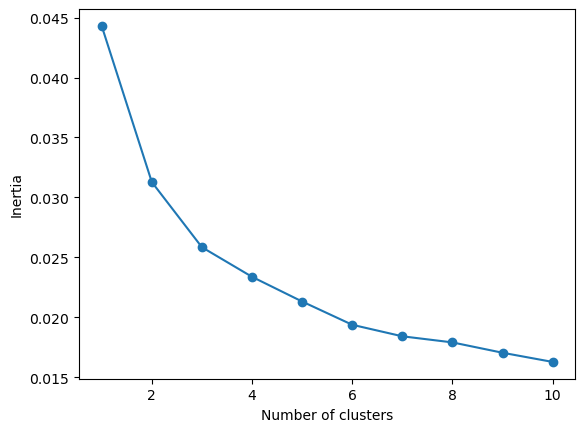

In [ ]:
inertia_values = []

# Попробуем количество кластеров от 1 до 10
for k in range(1, 11):
    # Создаем объект KMeans с текущим количеством кластеров
    kmeans = KMeans(n_clusters=k)
    # Обучаем модель на данных
    kmeans.fit(df_test)
    # Сохраняем значение инерции
    inertia_values.append(kmeans.inertia_)
    
# Выводим график зависимости инерции от количества кластеров
plt.plot(range(1, 11), inertia_values, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

На графике видно, что разница сумм инерации выше на отрезке от 1 кластера до 2

In [ ]:
diff = np.diff(inertia_values)
diff

array([-0.01302329, -0.00543764, -0.00246861, -0.00206036, -0.00194092,
       -0.00096184, -0.00050882, -0.00086315, -0.00076558])

In [ ]:
sum_diff = diff[1:].size
for i in range(0,sum_diff-1):
    df = diff[i+1]-diff[i]
    if df > 0.005:
        print('cluster = ' + str(i+2) +' = '+ str(df))

cluster = 2 = 0.007585650309920311


## Create KMeans with Elbow Rule

Строим модель KMeans с использование метода логтя с пороговым значением разницы инерций 0,005

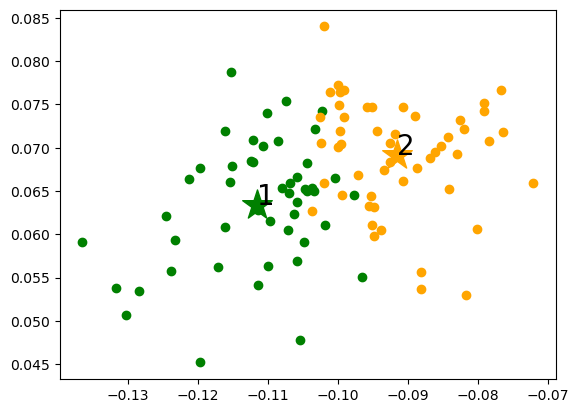

In [ ]:
inertia_values = []
X,y = df_test.values,df_test.index
colors = ['green', 'orange', 'red', 'navy', 'pink', 'yellow', 'black','blue']

# Попробуем количество кластеров от 1 до 10
for k in range(1, 11):
    # Создаем объект KMeans с текущим количеством кластеров
    kmeans = KMeans(n_clusters=k)
    # Обучаем модель на данных
    kmeans.fit(X)
    # Сохраняем значение инерции
    inertia_values.append(kmeans.inertia_)

# Проверяем разницу между значениями инерции
diff = np.diff(inertia_values)
diff
# Ищем первое изменение инерции больше 0.3
sum_diff = diff[1:].size
for i in range(0,sum_diff-1):
    df = diff[i+1]-diff[i]
    if df > 0.005:
        nCluster = i+2
nCluster
# Создаем объект KMeans с выбранным количеством кластеров и обучаем модель на данных
kmeans = KMeans(n_clusters=nCluster)
kmeans.fit(X)
centroids = kmeans.cluster_centers_
clusters = kmeans.predict(X)
# centroids, clusters = kmeans(X)
# # plt.figure(figsize=(7, 7))

for i in range(nCluster):
    plt.scatter(X[clusters == i, 0], X[clusters == i, 1], color=colors[i])

for i, centr in enumerate(centroids):
    plt.scatter(centr[0], centr[1], marker='*', s=500, c=colors[i])
    plt.text(centr[0], centr[1], f'{i+1}', fontsize=20);
    #plt.text(centr[0]-0.1, centr[1]-0.2, f'{i+1}', fontsize=20);

Отобразим на представлении аудиозаписи найденные кластеры

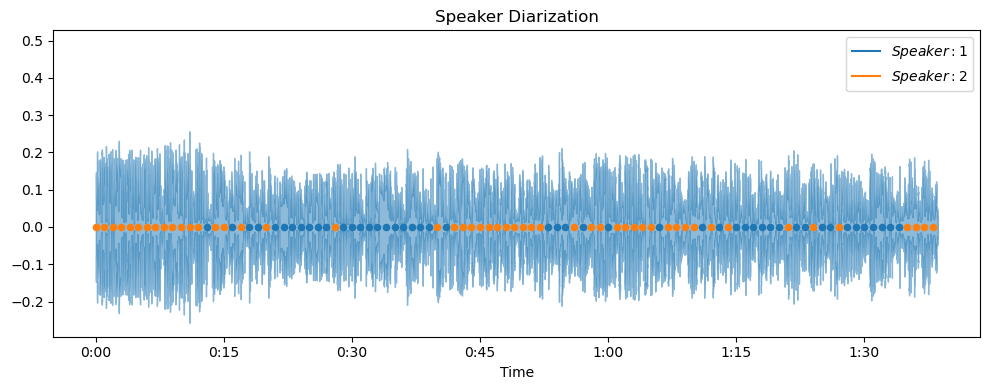

In [ ]:
# построение графика
n_clusters=nCluster
plt.figure(figsize=(10, 4))
data, sr = librosa.load(namesilence)

librosa.display.waveshow(data, sr=sr, alpha=0.5)

for i in range(n_clusters):
    plt.plot(0.7,0.7**2, label=r'$Speaker:$'+ str(i+1), color=f'C{i}')
    plt.legend(fontsize=10)
    plt.scatter(np.where(clusters == i)[0] * librosa.samples_to_time(sr), np.zeros(np.sum(clusters == i)), color=f'C{i}', s=20)
    plt.title('Speaker Diarization')
    plt.tight_layout()
plt.show()